# Assignment: Panorama Image Stitching
- Alumno 1:
- Alumno 2:
- Alumno 3:

The goal of the programming project in the “Fundamentos de Análisis de Imagen” course is to put into
practice your understanding of the material covered in class to develop proficiency in using the OpenCV
library for digital image processing, emphasizing fundamentals of feature description, image warping and
matching. Note that you cannot use the Stitcher class of OpenCV.

Follow the link above to download the images: [https://drive.upm.es/s/mW7CrA0V6idTTvW](https://drive.upm.es/s/mW7CrA0V6idTTvW)

In [ ]:
import os
import cv2
import copy
import itertools
import numpy as np

print("OpenCV " + cv2.__version__)

OpenCV 4.6.0


In [ ]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [40, 10] # figure size in inches

def draw_images(imgs):
    if len(imgs) > 1:
        fig, axs = plt.subplots(1, len(imgs))
        for idx, img in enumerate(imgs):
            axs[idx].axis("off")
            axs[idx].imshow(img)
    else:
        fig, ax = plt.subplots()
        ax.axis("off")
        ax.imshow(imgs[0])
    plt.show()

## **Part 1: Homography-based planar object detection**

In [ ]:
filenames = ["images/pkmn.png", "images/bus.png"]

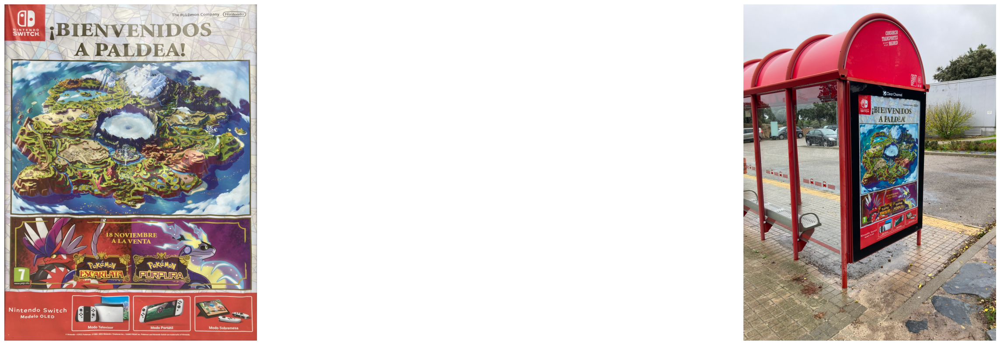

In [ ]:
### TODO
# Draw images
draw_images(imgs)

#### Detect keypoints and extract local invariant descriptors from the two input images.

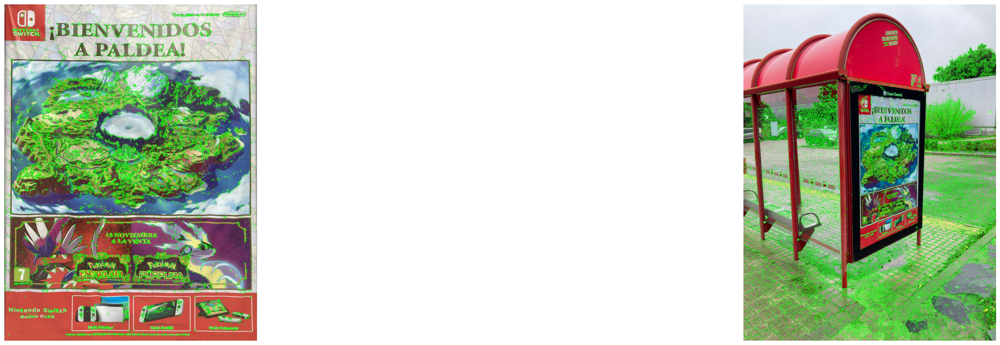

In [ ]:
### TODO
# Draw key points
_imgs = copy.deepcopy(imgs)
for idx in range(len(_imgs)):
    cv2.drawKeypoints(_imgs[idx], keypoints[idx], _imgs[idx], (0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
draw_images(_imgs)

#### Match the descriptors between the two images.

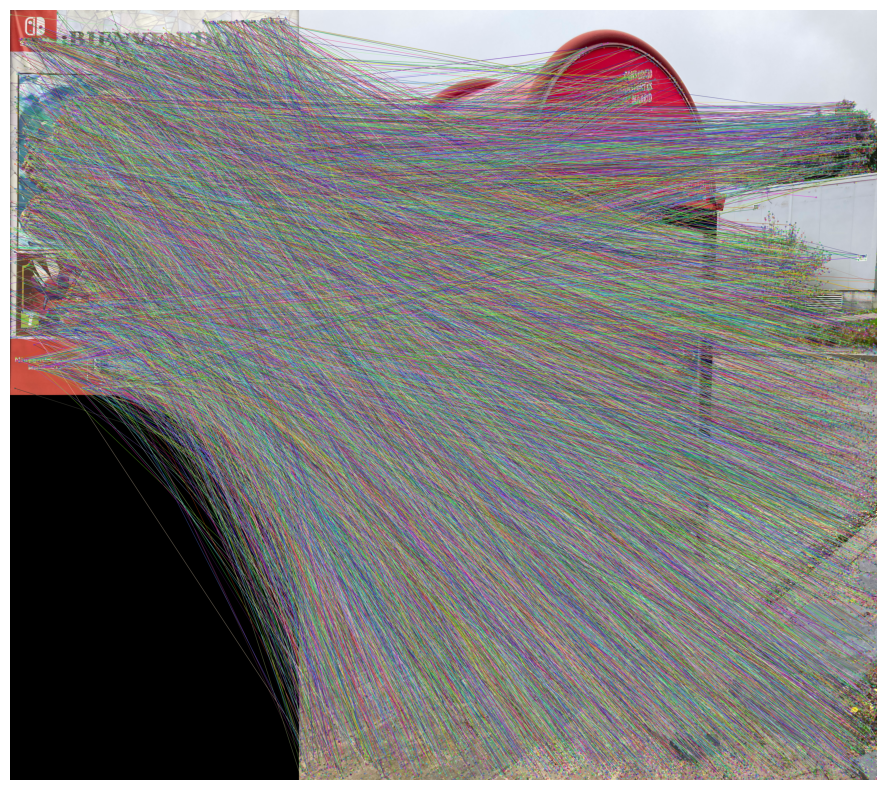

In [ ]:
### TODO
# Draw all matches
img = cv2.drawMatches(imgs[0], keypoints[0], imgs[1], keypoints[1], matches, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
draw_images([img])

#### Use the RANSAC algorithm to estimate a homography matrix H using the matched feature vectors and draw correct matches.

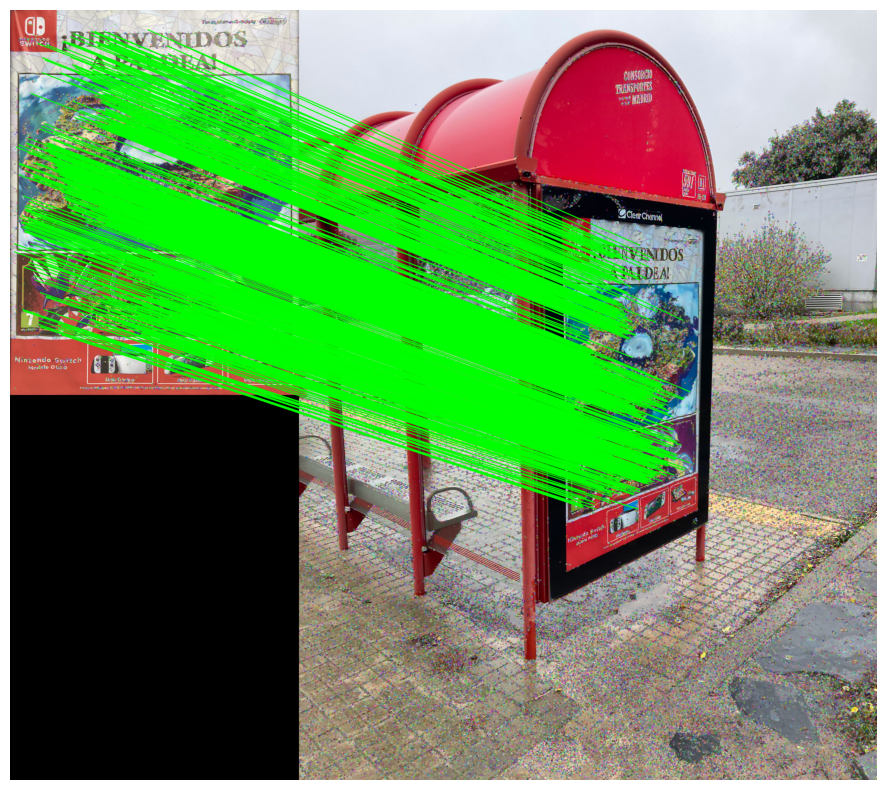

In [ ]:
### TODO
# Draw correct matches
draw_params = dict(matchColor=(0,255,0), singlePointColor=None, matchesMask=inliers.ravel().tolist(), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
img = cv2.drawMatches(imgs[0], keypoints[0], imgs[1], keypoints[1], matches, None, matchesThickness=3, **draw_params)
draw_images([img])

#### Once camera resectioning is done from an estimated homography, this information is used to insert another image, with the correct perspective, appearing to be part of the original scene.

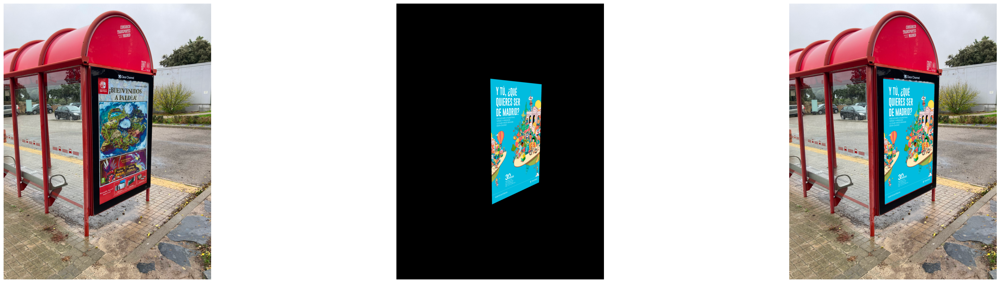

In [ ]:
### TODO
# Draw overlay
draw_images([imgs[1], proj_img, overlay])

## **Part 2: Stitch five images together to create a panorama**

In [ ]:
filenames = ["images/1.png", "images/2.png", "images/3.png", "images/4.png", "images/5.png"]

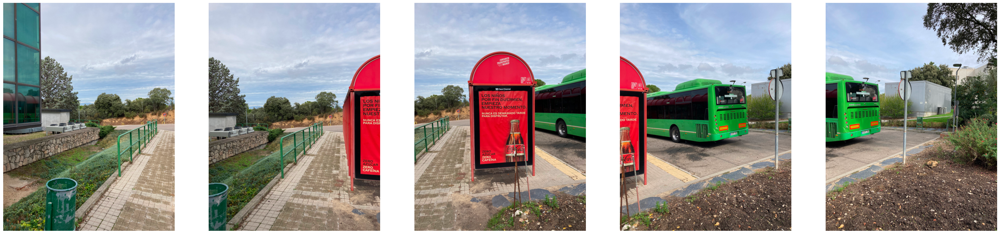

In [ ]:
### TODO
# Draw images
draw_images(imgs)

#### The goal of this part of the assignment is to combine five horizontally overlapping photographs into a single panoramic image. Images must be supplied in left-to-right order.

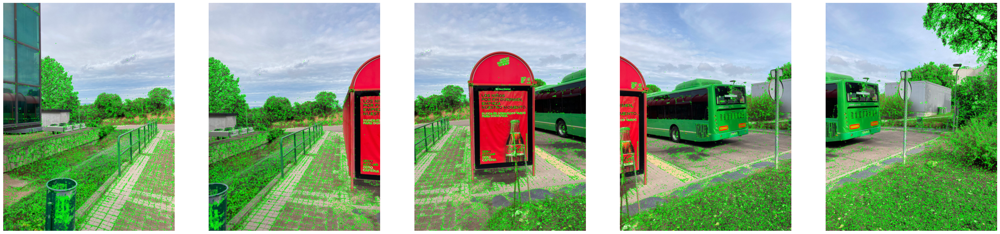

In [ ]:
### TODO
# Draw key points
_imgs = copy.deepcopy(imgs)
for idx in range(len(_imgs)):
    cv2.drawKeypoints(_imgs[idx], keypoints[idx], _imgs[idx], (0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
draw_images(_imgs)

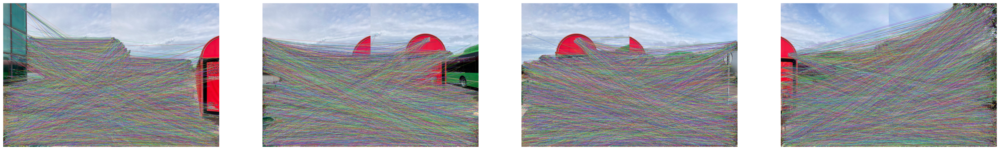

In [ ]:
### TODO
# Draw all matches
_imgs = []
for idx, (elem1, elem2) in enumerate(pairs):
    _imgs.append(cv2.drawMatches(imgs[elem1], keypoints[elem1], imgs[elem2], keypoints[elem2], matches[idx], None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT))
draw_images(_imgs)

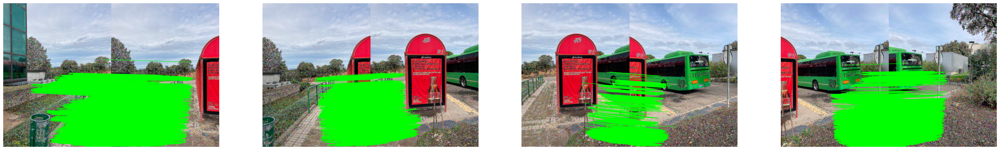

In [ ]:
### TODO
# Draw correct matches
_imgs = []
for idx, (elem1, elem2) in enumerate(pairs):
    draw_params = dict(matchColor=(0,255,0), singlePointColor=None, matchesMask=masks_inliers[idx], flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
    _imgs.append(cv2.drawMatches(imgs[elem1], keypoints[elem1], imgs[elem2], keypoints[elem2], matches[idx], None, matchesThickness=3, **draw_params))
draw_images(_imgs)

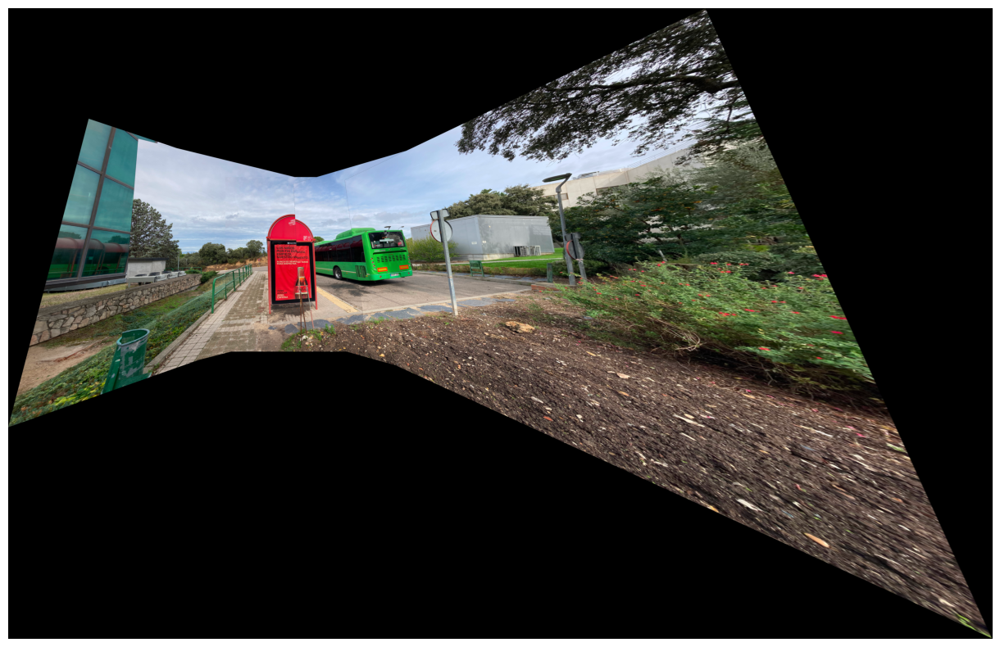

In [ ]:
### TODO
# Draw panorama
draw_images([img])

## **Part 3: Warp 7 images over a new projection to create a wide panorama**

In [ ]:
filenames = ["images/0.png", "images/1.png", "images/2.png", "images/3.png", "images/4.png", "images/5.png", "images/6.png"]

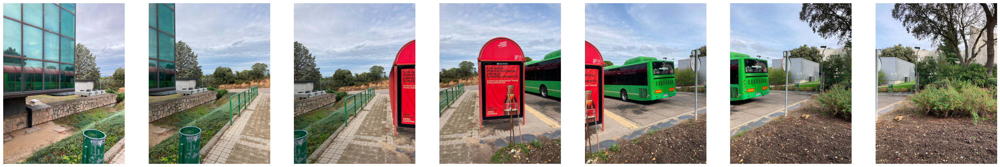

In [ ]:
### TODO
# Draw images
draw_images(imgs)

(1857, 5082, 3)


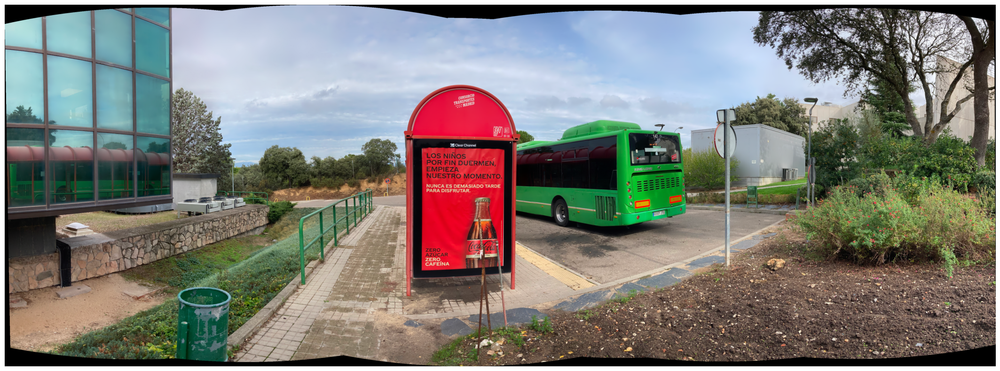

In [ ]:
### TODO
print(pano.shape)
# Draw image
fig = plt.figure()
plt.axis("off")
plt.imshow(pano);